# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

## Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

Business Objectives

1. Background: Used car dealer would like to limit the inventory to the cars popular among buyers. 

2. Goal: Understand what factors make a car more or less expensive 

3. Success Criterion: Reliable and clear recommendation to the client (an used car dealership) as to what consumers value in an used car

Situation Assessment 

1. Inventory of Resources:

    (a) Dataset from Kaggle

    (b) Python libraries: Pandas, NumPy, seaborn, plotly, sklearn etc. 

    (c) Regression algorithms taught in class
    
    (d) Class lectures, codio activities, try-it activities

2. Requirements, Assumptions, and Constraints:

    (a) Client is not specialized used car dealer i.e. doea not deal with ultra-luxury, off-road, buses, parts, or salvage cars. 

    (b) Client location is irrelevant/unknown and suggesting best place to sell an used car is out of the scope.


3. Risks and Contingencies terminology:

    (a) Lack of experience of personnel in model building and performing the analysis

    (b) Lack of latest data after pandemic which had significant impact of car prices and how people buy cars

    (c) Lack of computational resources to analyze such a large dataset. 

4. Costs and Benefits:

    (a) Limiting the inventory to cars popular among buyers would help the client sell cars faster

    (b) This would reduce the operational cost as well as improve cash flow to buy new inventory which would lead to more profitability. 

    (c) There are only human resource cost as the data is available free on Kaggle.  

Data Mining Goals

1. Data Problem Definition: Develop a regression model to predict an used car price using information/features available in the dataset and get feature importance

2. Data Mining Success Criteria：The regression model predicts the car prices in the test dataset within a reasonable MSE in order to get reliable feature importance

Preliminary Project Plan: 
1. Project Plan: Following CRISP-DM approach -

    (a) Data understanding: Explore and analyze the available dataset using visualization techniques

    (b) Data preparation: Remove unncessary columns and rows with null values and create a clean training, validation and test dataset 

    (c) Modeling: Train predictive models using algorithms in resource inventory and perform hyperparameter optimization using validation loss

    (d) Evaluation: Determine predictive on test dataset and determine feature importance

    (e) Deployment: Determine how features affect car prices and provide recommendations

2. Initial Assessment of Tools and Techniques - 

    (a) Regression algorithms taught in class - Linear regression, Ridge, Lasso from sklearn
    (b) Techniques taught in class: correlation matrix, sklearn Pipeline feature



## Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

### *Steps for data understanding*
1.  Import availale data as Pandas dataframe

    Explore data using Pandas capabilities - column data types, rows with null values
    
2.  Explore numeric columns and use seaborn/plotly to visualize data

3.  Explore categorical columns and use seaborn/plotly to visualize data

### 1. Data Import

* *Observations* 

   1. There are 426880 rows with 18 columns in the dataset. 

      Since 'id' and 'VIN' are definitely random identifiers for a car, they don't have any relevance to the price of the car. 

      To simplify, they can be dropped from the dataframe. 
    

   2. There are 3 numeric columns including the target/response i.e. price of the car.

      There are 13 categorical columns excluding the two identifier columns.

In [1]:
## importing libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import pandas as pd
import numpy as np
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [2]:
data = pd.read_csv('data/vehicles.csv')
print(data.columns)
print(data.shape)
data.head()

Index(['id', 'region', 'price', 'year', 'manufacturer', 'model', 'condition',
       'cylinders', 'fuel', 'odometer', 'title_status', 'transmission', 'VIN',
       'drive', 'size', 'type', 'paint_color', 'state'],
      dtype='object')
(426880, 18)


,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc


In [3]:
data.drop(['id','VIN'], axis = 1, inplace = True)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   region        426880 non-null  object 
 1   price         426880 non-null  int64  
 2   year          425675 non-null  float64
 3   manufacturer  409234 non-null  object 
 4   model         421603 non-null  object 
 5   condition     252776 non-null  object 
 6   cylinders     249202 non-null  object 
 7   fuel          423867 non-null  object 
 8   odometer      422480 non-null  float64
 9   title_status  418638 non-null  object 
 10  transmission  424324 non-null  object 
 11  drive         296313 non-null  object 
 12  size          120519 non-null  object 
 13  type          334022 non-null  object 
 14  paint_color   296677 non-null  object 
 15  state         426880 non-null  object 
dtypes: float64(2), int64(1), object(13)
memory usage: 52.1+ MB


In [4]:
num_cols = list(data._get_numeric_data().columns)
cat_cols = list(set(data.columns) - set(num_cols))

print(len(num_cols), len(cat_cols))
data[num_cols].columns, data[cat_cols].columns

3 13


(Index(['price', 'year', 'odometer'], dtype='object'),
 Index(['drive', 'state', 'manufacturer', 'region', 'size', 'condition',
        'title_status', 'model', 'transmission', 'type', 'paint_color',
        'cylinders', 'fuel'],
       dtype='object'))

### 2. Numerical features

* *Observations*

    1. Standard deviation in odometer and price is too high compared to 1st and 3rd quantiles due to few outliers.

    2. Restricing price to less than $100000 as beyond that price we venture into ultra-luxury cars whic only specialized car dealers sell. 

    3. Similarly, filtering out very old cars which might be vintage and skew the model would yield better model. 

        Moreover, we can remove cars with very high mileage which very few passenger cars can achieve. 

    4. Both year and odometer seem to have an effect on the price.

In [5]:
data.describe()

,price,year,odometer
count,4.268800e+05,425675.000000,4.224800e+05
mean,7.519903e+04,2011.235191,9.804333e+04
std,1.218228e+07,9.452120,2.138815e+05
min,0.000000e+00,1900.000000,0.000000e+00
25%,5.900000e+03,2008.000000,3.770400e+04
50%,1.395000e+04,2013.000000,8.554800e+04
75%,2.648575e+04,2017.000000,1.335425e+05
max,3.736929e+09,2022.000000,1.000000e+07


In [6]:
# ## Plotting histogram of numeric features
# fig = make_subplots(rows=3, cols=1, subplot_titles=("price","year", "odometer"))
# fig.append_trace(go.Histogram(x = data["price"]), row=1, col=1)
# fig.append_trace(go.Histogram(x = data["year"]), row=2, col=1)
# fig.append_trace(go.Histogram(x = data["odometer"]), row=3, col=1)

# fig.update_layout(height=600, width=900, showlegend=False)
# fig.show()

The above cell is commented to reduce the size of the file

In [7]:
# Filtering data to 1000<price<50000
data = data[(data.price<50000) & (data.price>1000)]
print(data.shape)

# Restricting Year to only after 2000
data = data[data.year>2000]
print(data.shape)

# Restricting the Odometer to 300000
data = data[data.odometer<300000]
print(data.shape)

(366315, 16)
(339338, 16)
(335754, 16)


In [8]:
## Plotting histogram of numeric features

fig = make_subplots(rows=3, cols=1, subplot_titles=("price","year", "odometer"))
fig.append_trace(go.Histogram(x = data["price"]), row=1, col=1)
fig.append_trace(go.Histogram(x = data["year"]), row=2, col=1)
fig.append_trace(go.Histogram(x = data["odometer"]), row=3, col=1)

fig.update_layout(height=600, width=900, showlegend=False)
fig.show()

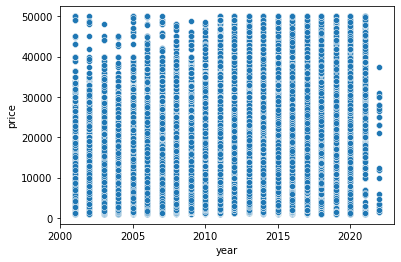

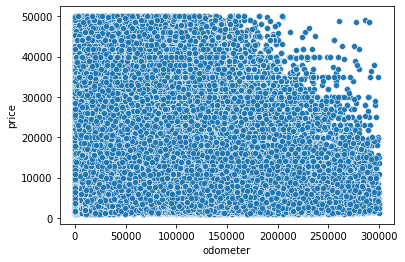

In [9]:
## Plotting price vs numeric features
sns.scatterplot(x=data['year'], y=data['price'])
plt.show()
sns.scatterplot(x=data['odometer'], y=data['price'])
plt.show()

### 3. Categorical features

In [10]:
## Number of unique values for each categorical column
for column in cat_cols: 
        print(column, len(data[column].unique()))

drive 4
state 51
manufacturer 42
region 404
size 5
condition 7
title_status 7
model 21074
transmission 4
type 14
paint_color 13
cylinders 9
fuel 6


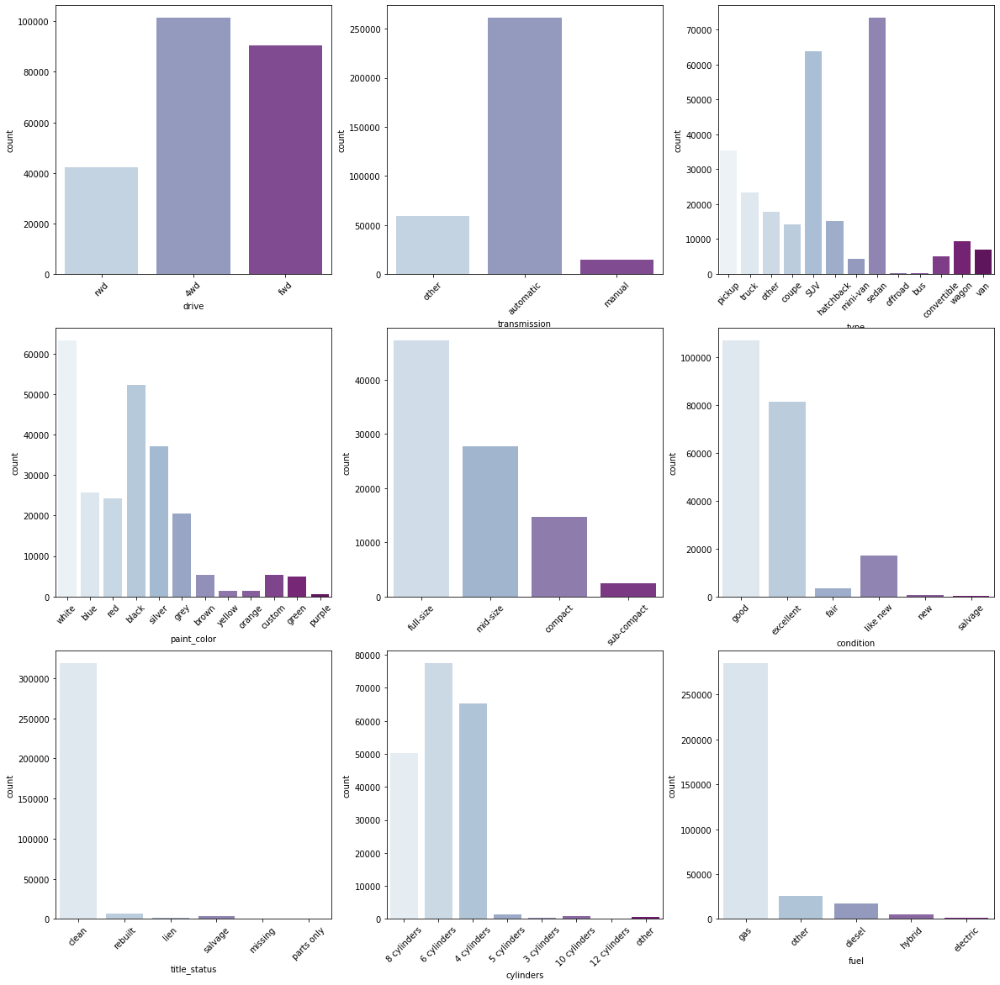

In [11]:
## Value counts for each categorical column excluding the ones with to many unique values 
cat_cols_plot = list(set(cat_cols) - set(['state', 'region', 'manufacturer', 'model']))

# for column in cat_cols_plot: 
#         print(data[column].value_counts()) 

fig , ax = plt.subplots(3, 3, figsize = (20,20)) 
for i , subplots in zip (cat_cols_plot, ax.flatten()):
  sns.countplot(data=data, x = i, ax = subplots, palette = 'BuPu')
  subplots.tick_params(axis='x', rotation=45)
plt.show()

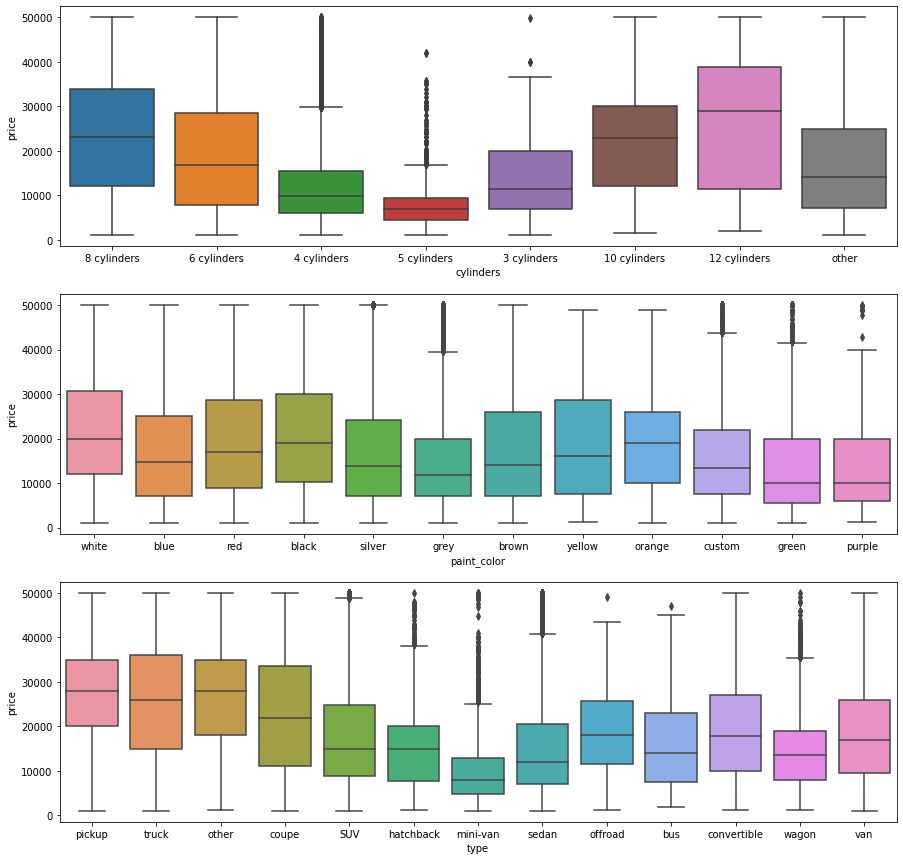

In [12]:
## Box plot between price and various categorical variables
# fig = make_subplots(rows=3, cols=1, subplot_titles=("cylinders","paint_color", "type"))
# fig.append_trace(go.Box(y = data['price'], x = data['cylinders']), row=1, col=1)
# fig.append_trace(go.Box(y = data['price'], x = data['paint_color']), row=2, col=1)
# fig.append_trace(go.Box(y = data['price'], x = data['type']), row=3, col=1)

# fig.update_layout(height=900, width=1000, showlegend=False)
# fig.show()

fig, axes = plt.subplots(3, 1, figsize=(15, 15), sharey=True)
sns.boxplot(ax=axes[0], y = data['price'], x = data['cylinders'])
sns.boxplot(ax=axes[1], y = data['price'], x = data['paint_color'])
sns.boxplot(ax=axes[2], y = data['price'], x = data['type'])
plt.show()

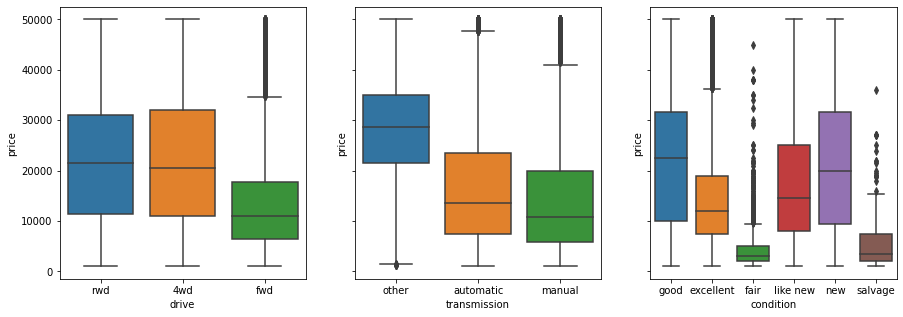

In [13]:
## Box plot between price and various categorical variables
# fig = make_subplots(rows=1, cols=3, subplot_titles=("drive","transmission", "condition"))
# fig.append_trace(go.Box(y = data['price'], x = data['drive']), row=1, col=1)
# fig.append_trace(go.Box(y = data['price'], x = data['transmission']), row=1, col=2)
# fig.append_trace(go.Box(y = data['price'], x = data['condition']), row=1, col=3)

# fig.update_layout(height=400, width=1000, showlegend=False)
# fig.show()

fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)
sns.boxplot(ax=axes[0], y = data['price'], x = data['drive'])
sns.boxplot(ax=axes[1], y = data['price'], x = data['transmission'])
sns.boxplot(ax=axes[2], y = data['price'], x = data['condition'])
plt.show()

## Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

* Conclusions from data understanding and steps for data preparation 

1. Features for predicting *price* of the car available in the dataset fall in the following categories - 

    (a) Location: region, state

    (b) Car features: cylinders, fuel, transmission, drive, size, type, paint_color, manufacturer, model

    (c) Car history: year, condition, odometer, title_status, manufacturer, model

2. *Region* and *State* can be excluded from the feature list as client location is unknown and we can assume that suggesting best place to sell an used car may be out of scope for this analysis. 

3.  The model of the car is determined by most of the other car features, hence they are not independent. Therefore, the car model can be ignored from the analysis. 

4. Assuming non-specialized used car dealership as client, new and salvage cars, vehicles of type offroad and bus. Cars with title status except 'clean' would have lower price with all other things equal and may cause problems in model training.  

5. The categorical features need to be encoded. Ordinal = cylinders and condition, nominal = all else

6. The range of numeric features vary significantly, hence they need to be scaled.  

In [14]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder, OrdinalEncoder, PolynomialFeatures
from sklearn.compose import make_column_transformer, ColumnTransformer, make_column_selector
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.feature_selection import SequentialFeatureSelector, SelectFromModel
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import mean_squared_error
from sklearn.pipeline import Pipeline

In [15]:
## Restricting cylinders to 8, 6 and 4
print(data.shape)

# Drop region and State variables
data_cleaned = data.drop(['region', 'state'], axis = 1)
print(data_cleaned.shape)

# Removing New and Salvage cars
data_cleaned = data_cleaned[~data_cleaned.condition.isin(['new', 'salvage'])]
print(data_cleaned.shape)

# Removing offroad and bus cars
data_cleaned = data_cleaned[~data_cleaned.type.isin(['offroad', 'bus'])]
print(data_cleaned.shape)

# Only keeping cars with clean title status
data_cleaned = data_cleaned[data_cleaned.title_status.isin(['clean'])]
print(data_cleaned.shape)

# Only keeping cars with clean title status
data_cleaned = data_cleaned[data_cleaned.cylinders.isin(['4 cylinders', '6 cylinders', '8 cylinders'])]
print(data_cleaned.shape)

(335754, 16)
(335754, 14)
(334731, 14)
(334083, 14)
(317418, 14)
(178757, 14)


In [16]:
data_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 178757 entries, 27 to 426878
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         178757 non-null  int64  
 1   year          178757 non-null  float64
 2   manufacturer  174620 non-null  object 
 3   model         177877 non-null  object 
 4   condition     132777 non-null  object 
 5   cylinders     178757 non-null  object 
 6   fuel          177768 non-null  object 
 7   odometer      178757 non-null  float64
 8   title_status  178757 non-null  object 
 9   transmission  178587 non-null  object 
 10  drive         152981 non-null  object 
 11  size          76990 non-null   object 
 12  type          160691 non-null  object 
 13  paint_color   150307 non-null  object 
dtypes: float64(2), int64(1), object(11)
memory usage: 20.5+ MB


In [17]:
features1 = ['price', 'year', 'odometer', 'condition', 'cylinders', 'fuel', 'transmission', 'drive', 'type', 'paint_color','manufacturer'] #car_features
## Ignored features = model, size
data_features1 = data_cleaned[features1].dropna()

## Split data into train and test to avoid data leakage
X = data_features1[features1].drop('price', axis=1)
y = data_features1['price']

# train, test = train_test_split(data_features1, test_size=0.2, random_state = 42) 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state = 42)
print(data_features1.shape, X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(89493, 11) (71594, 10) (17899, 10) (71594,) (17899,)


In [18]:
numeric_feats = ['year', 'odometer']
passthrough_feats = []
ordinal_feats = ['condition', 'cylinders']
nominal_feats = ['fuel', 'transmission', 'drive', 'type', 'paint_color','manufacturer']
drop_feats = []

categories=[['fair', 'good', 'excellent', 'like new'],
            ['3 cylinders', '4 cylinders', '5 cylinders', '6 cylinders', '8 cylinders', '10 cylinders', '12 cylinders', 'other']]

ct = make_column_transformer(  
        (StandardScaler(), numeric_feats),
        # ("passthrough", passthrough_feats),  # no transformations on the binary features 
        (OrdinalEncoder(categories=categories), ordinal_feats), 
        (OneHotEncoder(drop='if_binary'), nominal_feats),  # OHE on categorical features
        ("drop", drop_feats))

X_train_ct_array = ct.fit_transform(X_train).toarray()
X_test_ct_array = ct.transform(X_test).toarray()

column_names = (numeric_feats + passthrough_feats + ordinal_feats
    + ct.named_transformers_["onehotencoder"].get_feature_names(nominal_feats).tolist())

X_train_ct = pd.DataFrame(X_train_ct_array, columns = column_names, index = X_train.index)
X_test_ct = pd.DataFrame(X_test_ct_array, columns = column_names, index = X_test.index)
# X_train_ct.head(), X_test_ct.head()

# print(ct.named_transformers_["ordinalencoder"].categories_)

## Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

In [19]:
X_train_ct_corr=[]
for col_pos in range(len(X_train_ct.columns)):
    r = np.corrcoef(X_train_ct.iloc[:,col_pos], y_train)
    X_train_ct_corr.append(r[0,1])

X_train_ct_corr = pd.DataFrame(X_train_ct_corr, columns = ['pearson_r'], index = X_train_ct.columns)

X_train_ct_corr_sorted = X_train_ct_corr.sort_values(by = 'pearson_r', ascending=False)
fig = px.bar(X_train_ct_corr_sorted)
fig.update_xaxes(title_text='Features')
fig.update_yaxes(title_text='abs(Correlation Factor)')
fig.update_layout(height=500, width=900)
fig.show()

In [20]:
## Linear regression
def simple_cross_validation(X_train, y_train):
    best_pipe = None #placeholder for best model
    best_mse = np.inf #set best mse to infinity to begin
    train_mses = []
    val_mses = []

    X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state = 22)
    print(X_train.shape, X_val.shape)

    for degree in range(1,8):
        column_transformer = make_column_transformer(
            (PolynomialFeatures(degree = degree, include_bias=True), numeric_feats), remainder = 'passthrough')

        pipe = Pipeline([('transformer', column_transformer), ('linreg', LinearRegression())])

        pipe.fit(X_train,y_train)
        
        train_mse = mean_squared_error(pipe.predict(X_train), y_train)
        val_mse = mean_squared_error(pipe.predict(X_val), y_val)
        
        train_mses.append(train_mse)
        val_mses.append(val_mse)

        if val_mse < best_mse:
            best_mse = val_mse
            best_pipe = pipe

    return best_pipe, best_mse

best_model, best_val_mse = simple_cross_validation(X_train_ct, y_train)
test_mse = mean_squared_error(best_model.predict(X_test_ct), y_test) 

print(np.sqrt(best_val_mse))
print(np.sqrt(test_mse))
print(best_model.get_params())

fig = px.scatter(x = best_model.predict(X_train_ct), y = y_train, title="Train")
fig.update_xaxes(title_text='Predicted')
fig.update_yaxes(title_text='Actual')
fig.update_layout(height=300, width=500)
fig.show()

(57275, 75) (14319, 75)
4926.3369043116245
4893.340691422257
{'memory': None, 'steps': [('transformer', ColumnTransformer(remainder='passthrough',
                  transformers=[('polynomialfeatures',
                                 PolynomialFeatures(degree=7),
                                 ['year', 'odometer'])])), ('linreg', LinearRegression())], 'verbose': False, 'transformer': ColumnTransformer(remainder='passthrough',
                  transformers=[('polynomialfeatures',
                                 PolynomialFeatures(degree=7),
                                 ['year', 'odometer'])]), 'linreg': LinearRegression(), 'transformer__n_jobs': None, 'transformer__remainder': 'passthrough', 'transformer__sparse_threshold': 0.3, 'transformer__transformer_weights': None, 'transformer__transformers': [('polynomialfeatures', PolynomialFeatures(degree=7), ['year', 'odometer'])], 'transformer__verbose': False, 'transformer__polynomialfeatures': PolynomialFeatures(degree=7), 'transfo

In [21]:
## Ridge regression with gridsearh cv
column_transformer = make_column_transformer((PolynomialFeatures(include_bias=False), numeric_feats), remainder = 'passthrough')
# poly_features = PolynomialFeatures(include_bias=False)
regressor = Ridge()

pipe = Pipeline([   ('transformer', column_transformer),
                    ('regressor', regressor)
                ])

param_dict = {'transformer__polynomialfeatures__degree':[2, 3],
              'regressor__alpha': np.logspace(-2, 2, 20)}
grid_ridge = GridSearchCV(estimator=pipe, param_grid=param_dict, cv = 5)

grid_ridge.fit(X_train_ct, y_train)

train_mse = mean_squared_error(grid_ridge.best_estimator_.predict(X_train_ct), y_train)
test_mse = mean_squared_error(grid_ridge.best_estimator_.predict(X_test_ct), y_test)

print(np.sqrt(train_mse), np.sqrt(test_mse))

polyfeaturenames = grid_ridge.best_estimator_.named_steps['transformer'].named_transformers_["polynomialfeatures"].get_feature_names(numeric_feats)
feature_names = polyfeaturenames+ grid_ridge.best_estimator_.named_steps['transformer'].get_feature_names()[len(polyfeaturenames):]
ridge_coeff = pd.DataFrame(grid_ridge.best_estimator_.named_steps['regressor'].coef_, index = feature_names)

fig = px.bar(ridge_coeff, title="Ridge Coeff")
fig.layout.update(showlegend=False, yaxis={'visible': False, 'showticklabels': False})
fig.show()

fig = px.scatter(x = grid_ridge.best_estimator_.predict(X_train_ct), y = y_train, title="Train")
fig.update_xaxes(title_text='Predicted')
fig.update_yaxes(title_text='Actual')
fig.update_layout(height=300, width=500)
fig.show()

4945.917079742528 4985.0893989928145


In [22]:
## Lasso with gridsearh cv
column_transformer = make_column_transformer((PolynomialFeatures(include_bias=False), numeric_feats), remainder = 'passthrough')
regressor = Lasso(random_state = 42)

pipe = Pipeline([   ('transformer', column_transformer),
                    ('regressor', regressor)
                ])

param_dict = {'transformer__polynomialfeatures__degree':[1, 2, 3, 4, 5]}
grid_lasso = GridSearchCV(estimator=pipe, param_grid=param_dict, cv = 5)

grid_lasso.fit(X_train_ct, y_train)

train_mse = mean_squared_error(grid_lasso.best_estimator_.predict(X_train_ct), y_train)
test_mse = mean_squared_error(grid_lasso.best_estimator_.predict(X_test_ct), y_test)

print(np.sqrt(train_mse), np.sqrt(test_mse))

polyfeaturenames = grid_lasso.best_estimator_.named_steps['transformer'].named_transformers_["polynomialfeatures"].get_feature_names(numeric_feats)
feature_names = polyfeaturenames+ grid_lasso.best_estimator_.named_steps['transformer'].get_feature_names()[len(polyfeaturenames):]
lasso_coeff = pd.DataFrame(grid_lasso.best_estimator_.named_steps['regressor'].coef_, index = feature_names)

print('Eliminated features by Lasso', lasso_coeff[lasso_coeff[0]==0].index)

fig = px.bar(lasso_coeff[~(lasso_coeff[0]==0)], title="Lasso Coeff")
fig.layout.update(showlegend=False, yaxis={'visible': False, 'showticklabels': False})
fig.show()

fig = px.scatter(x = grid_lasso.best_estimator_.predict(X_train_ct), y = y_train, title="Train")
fig.update_xaxes(title_text='Predicted')
fig.update_yaxes(title_text='Actual')
fig.update_layout(height=300, width=500)
fig.show()

/Users/walvekaa/opt/miniconda3/envs/viability_pred/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 30355286743.417847, tolerance: 794639990.1579632

/Users/walvekaa/opt/miniconda3/envs/viability_pred/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 18189455252.01172, tolerance: 795589985.0961764

/Users/walvekaa/opt/miniconda3/envs/viability_pred/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 48892191521.194336, tolerance: 797081254.6399212

/Users/walvekaa/opt/miniconda3/envs/viability_pred/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py

4896.410706918451 4938.925774358923
Eliminated features by Lasso Index(['fuel_electric', 'fuel_other', 'transmission_manual', 'drive_rwd',
       'type_van', 'paint_color_black', 'paint_color_custom',
       'paint_color_red', 'manufacturer_bmw', 'manufacturer_harley-davidson',
       'manufacturer_land rover', 'manufacturer_saturn',
       'manufacturer_subaru'],
      dtype='object')


/Users/walvekaa/opt/miniconda3/envs/viability_pred/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 39471040547.15503, tolerance: 993798788.1014236



In [23]:
## Lasso as column selector then Ridge regression 
column_transformer = make_column_transformer((PolynomialFeatures(include_bias=False), numeric_feats), remainder = 'passthrough')
regressor = Ridge()

pipe = Pipeline([   ('transformer', column_transformer),
                    ('selector', SelectFromModel(Lasso())),
                    ('regressor', regressor)
                ])

param_dict = {'transformer__polynomialfeatures__degree':[1, 2, 3, 4, 5]}
grid_lasso_ridge = GridSearchCV(estimator=pipe, param_grid=param_dict, cv = 5)

grid_lasso_ridge.fit(X_train_ct, y_train)

train_mse = mean_squared_error(grid_lasso_ridge.best_estimator_.predict(X_train_ct), y_train)
test_mse = mean_squared_error(grid_lasso_ridge.best_estimator_.predict(X_test_ct), y_test)

print(np.sqrt(train_mse), np.sqrt(test_mse))

polyfeaturenames = grid_lasso_ridge.best_estimator_.named_steps['transformer'].named_transformers_["polynomialfeatures"].get_feature_names(numeric_feats)
feature_names = polyfeaturenames+ grid_lasso_ridge.best_estimator_.named_steps['transformer'].get_feature_names()[len(polyfeaturenames):]
feature_idx = grid_lasso_ridge.best_estimator_.named_steps['selector'].get_support()
ridge_coeff = pd.DataFrame(grid_lasso_ridge.best_estimator_.named_steps['regressor'].coef_, index = [feature_names[i] for i in range(len(feature_idx)) if feature_idx[i]])

print('Eliminated features by Lasso', ridge_coeff[ridge_coeff[0]==0].index)

fig = px.bar(ridge_coeff[~(ridge_coeff[0]==0)], title="Ridge Coeff")
fig.layout.update(showlegend=False, yaxis={'visible': False, 'showticklabels': False})
fig.show()

fig = px.scatter(x = grid_lasso_ridge.best_estimator_.predict(X_train_ct), y = y_train)
fig.update_xaxes(title_text='Predicted')
fig.update_yaxes(title_text='Actual')
fig.update_layout(height=300, width=500)
fig.show()

/Users/walvekaa/opt/miniconda3/envs/viability_pred/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 30355286743.417847, tolerance: 794639990.1579632

/Users/walvekaa/opt/miniconda3/envs/viability_pred/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 18189455252.01172, tolerance: 795589985.0961764

/Users/walvekaa/opt/miniconda3/envs/viability_pred/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 48892191521.194336, tolerance: 797081254.6399212

/Users/walvekaa/opt/miniconda3/envs/viability_pred/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py

4895.4566749509695 4938.705454294308
Eliminated features by Lasso Index([], dtype='object')


### Sequential Feature Selection and Recursive Feature Elimination

These models didn't finish training after more than 10 hours. So results were obtained. 

In [24]:
# # Sequential Feature Selection using linear regression with gridsearh cv
# column_transformer = make_column_transformer((PolynomialFeatures(include_bias=False), numeric_feats), remainder = 'passthrough')
# # poly_features = PolynomialFeatures(include_bias=False)
# selector = SequentialFeatureSelector(estimator=LinearRegression(), scoring='neg_mean_squared_error')
# backward_selector = SequentialFeatureSelector(estimator=LinearRegression(), scoring='neg_mean_squared_error', direction = 'backward')
# regressor = LinearRegression()

# pipe = Pipeline([   ('transformer', column_transformer),
#                     ('column_selector', selector),
#                     ('regressor', regressor)
#                 ])

# param_dict = {'transformer__polynomialfeatures__degree':[3],
#               'column_selector__n_features_to_select':[15, 25, 50]}
# grid = GridSearchCV(estimator=pipe, param_grid=param_dict, cv = 2)

# grid.fit(X_train_ct, y_train)
# train_mse = mean_squared_error(grid.best_estimator_.predict(X_train_ct), y_train)
# test_mse = mean_squared_error(grid.best_estimator_.predict(X_test_ct), y_test)

# print(np.sqrt(train_mse), np.sqrt(test_mse))

# fig = px.scatter(x = grid.best_estimator_.predict(X_train_ct), y = y_train)
# fig.update_xaxes(title_text='Predicted')
# fig.update_yaxes(title_text='Actual')
# fig.update_layout(height=300, width=500)
# fig.show()

# fig = px.scatter(x = grid.best_estimator_.predict(X_test_ct), y = y_test)
# fig.update_xaxes(title_text='Predicted')
# fig.update_yaxes(title_text='Actual')
# fig.update_layout(height=300, width=500)
# fig.show()

In [25]:
# Sequential Feature Selection with cv

# seed(42)
# all_indicies = list(df.index)
# shuffle(all_indicies)
# train_idx, test_idx = np.split(all_indicies, [350])

# selector = SequentialFeatureSelector(estimator=LinearRegression(), scoring='neg_mean_squared_error',
#                                     n_features_to_select=4, cv=[[train_idx, test_idx]])

In [26]:
# ## Lasso as column selector for SFS then Ridge/linear regression
# column_transformer = make_column_transformer((PolynomialFeatures(include_bias=False), numeric_feats), remainder = 'passthrough')
# selector = SequentialFeatureSelector(estimator=Lasso(), scoring='neg_mean_squared_error')
# regressor = Ridge()

# pipe = Pipeline([   ('transformer', column_transformer),
#                     ('selector', selector),
#                     ('regressor', regressor)
#                 ])

# param_dict = {'transformer__polynomialfeatures__degree':[1, 2, 3, 4, 5],
#               'selector__n_features_to_select':[15, 25, 50], 
#               'regressor__alpha': np.logspace(-2, 2, 20)}
# grid = GridSearchCV(estimator=pipe, param_grid=param_dict, cv = 5)

# grid.fit(X_train_ct, y_train)

# train_mse = mean_squared_error(grid.best_estimator_.predict(X_train_ct), y_train)
# test_mse = mean_squared_error(grid.best_estimator_.predict(X_test_ct), y_test)

# print(np.sqrt(train_mse), np.sqrt(test_mse))

# fig = px.scatter(x = grid.best_estimator_.predict(X_train_ct), y = y_train)
# fig.update_xaxes(title_text='Predicted')
# fig.update_yaxes(title_text='Actual')
# fig.update_layout(height=300, width=500)
# fig.show()

# fig = px.scatter(x = grid.best_estimator_.predict(X_test_ct), y = y_test)
# fig.update_xaxes(title_text='Predicted')
# fig.update_yaxes(title_text='Actual')
# fig.update_layout(height=300, width=500)
# fig.show()

In [27]:
# ## Lasso as column selector for RFE then Ridge/linear regression
# column_transformer = make_column_transformer((PolynomialFeatures(include_bias=False), numeric_feats), remainder = 'passthrough')
# selector = RFE(estimator=Lasso(), scoring='neg_mean_squared_error')
# regressor = Ridge()

# pipe = Pipeline([   ('transformer', column_transformer),
#                     ('selector', selector),
#                     ('regressor', regressor)
#                 ])

# param_dict = {'transformer__polynomialfeatures__degree':[1, 2, 3, 4, 5],
#               'selector__n_features_to_select':[15, 25, 50], 
#               'regressor__alpha': np.logspace(-2, 2, 20)}
# grid = GridSearchCV(estimator=pipe, param_grid=param_dict, cv = 5)

# grid.fit(X_train_ct, y_train)

# train_mse = mean_squared_error(grid.best_estimator_.predict(X_train_ct), y_train)
# test_mse = mean_squared_error(grid.best_estimator_.predict(X_test_ct), y_test)

# print(np.sqrt(train_mse), np.sqrt(test_mse))

# fig = px.scatter(x = grid.best_estimator_.predict(X_train_ct), y = y_train)
# fig.update_xaxes(title_text='Predicted')
# fig.update_yaxes(title_text='Actual')
# fig.update_layout(height=300, width=500)
# fig.show()

# fig = px.scatter(x = grid.best_estimator_.predict(X_test_ct), y = y_test)
# fig.update_xaxes(title_text='Predicted')
# fig.update_yaxes(title_text='Actual')
# fig.update_layout(height=300, width=500)
# fig.show()

## Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

Based on the earlier model results, the dataset and features were adjusted to get the best training results.
For example, restricting the dataset to price less $50000, adding condition and cylinders to ordinal features. 

The plot show still significant variability and RMSE is quite high. However, predictions show good linearity. The high RMSE maybe due to ignoring the feature 'car model'. However, including that feature exhausted the computational resources available. 

In [28]:
# fig = make_subplots(rows=1, cols=2, subplot_titles=("Train", "Test"))
# fig.append_trace(go.Scatter(x = grid_lasso_ridge.best_estimator_.predict(X_train_ct), y = y_train, mode = 'markers'), row=1, col=1)
# fig.append_trace(go.Scatter(x = grid_lasso_ridge.best_estimator_.predict(X_test_ct), y = y_test, mode = 'markers'), row=1, col=2)
# fig.update_layout(height=300, width=800, showlegend=False)
# fig.show()

## Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.